## Imports & paths

In [1]:
%matplotlib inline
from __future__ import print_function, unicode_literals
import sys, os
import datetime as dt
import seaborn as sns
import numpy as np
import matplotlib
from matplotlib import pyplot as plt

In [2]:
from pygaarst import raster
import pandas as pd
import geopandas as gp
from fiona.crs import from_string
import shapely.ops
from shapely.geometry import Point
from matplotlib.collections import PatchCollection
from descartes import PolygonPatch

In [3]:
from mpl_toolkits.axes_grid1.inset_locator import zoomed_inset_axes, mark_inset

In [4]:
sys.path.append('../firedetection/')
import landsat8fire as lfire

In [5]:
reload(lfire)

<module 'landsat8fire' from '../firedetection/landsat8fire.pyc'>

In [6]:
sns.set(rc={'image.cmap': 'gist_heat'})
sns.set(rc={'image.cmap': 'bone'})

sns.set_context("poster")

myfontsize = 20
font = {'family' : 'Calibri',
        'weight': 'bold',
        'size'   : myfontsize}
matplotlib.rc('font', **font)
matplotlib.axes.rcParams['axes.labelsize']=myfontsize-4
matplotlib.axes.rcParams['axes.titlesize']=myfontsize
cmap1 =  matplotlib.colors.ListedColormap(sns.xkcd_palette(['white', 'red']))
cmap2 =  matplotlib.colors.ListedColormap(sns.xkcd_palette(['white', 'neon green']))
cmap3 =  matplotlib.colors.ListedColormap(sns.xkcd_palette(['white', 'orange']))

In [7]:
productdir = '/Volumes/SCIENCE_mobile_Mac/Fire/DATA_BY_PROJECT/2015VIIRSMODIS/rasterout/'

In [8]:
gisdir = "/Volumes/SCIENCE_mobile_Mac/Fire/DATA_BY_PROJECT/2015VIIRSMODIS/GISout/"
#newviirspolydf = gp.GeoDataFrame.from_file(os.path.join(gisdir, '2016YFviirsspoly.shp'))
newviirspolydf = gp.GeoDataFrame.from_file(os.path.join(gisdir, '2016YKviirsspoly_20160719.shp'))

## Landsat data loading

In [9]:
landsatpath = '/Volumes/SCIENCE_mobile_Mac/Fire/DATA_BY_PROJECT/2015VIIRSMODIS/Landsat/L8 OLI_TIRS AK 2016/'
lsscene = 'LC80740132016197LGN00'
landsat = raster.Landsatscene(os.path.join(landsatpath, lsscene))

In [10]:
landsat.infix = '_clip'

In [11]:
rho7 = landsat.band7.reflectance
rho6 = landsat.band6.reflectance
rho5 = landsat.band5.reflectance
rho1 = landsat.band1.reflectance

In [12]:
xmax = landsat.band7.ncol
ymax = landsat.band7.nrow

In [13]:
rgb753scene = raster.GeoTIFF(os.path.join(landsatpath, lsscene, 'LC80740132016197LGN00_fc753_8bit_clip.tif'))
rgb753 = np.rollaxis(rgb753scene.data, 0, 3)
rgb764scene = raster.GeoTIFF(os.path.join(landsatpath, lsscene, 'LC80740132016197LGN00_fc764_8bit_clip.tif'))
rgb764 = np.rollaxis(rgb753scene.data, 0, 3)

## Exploration of fire processing

In [54]:
water = lfire.get_l8watermask(landsat)

In [55]:
water_masked = np.ma.masked_where(
        ~water, np.ones((ymax, xmax)))

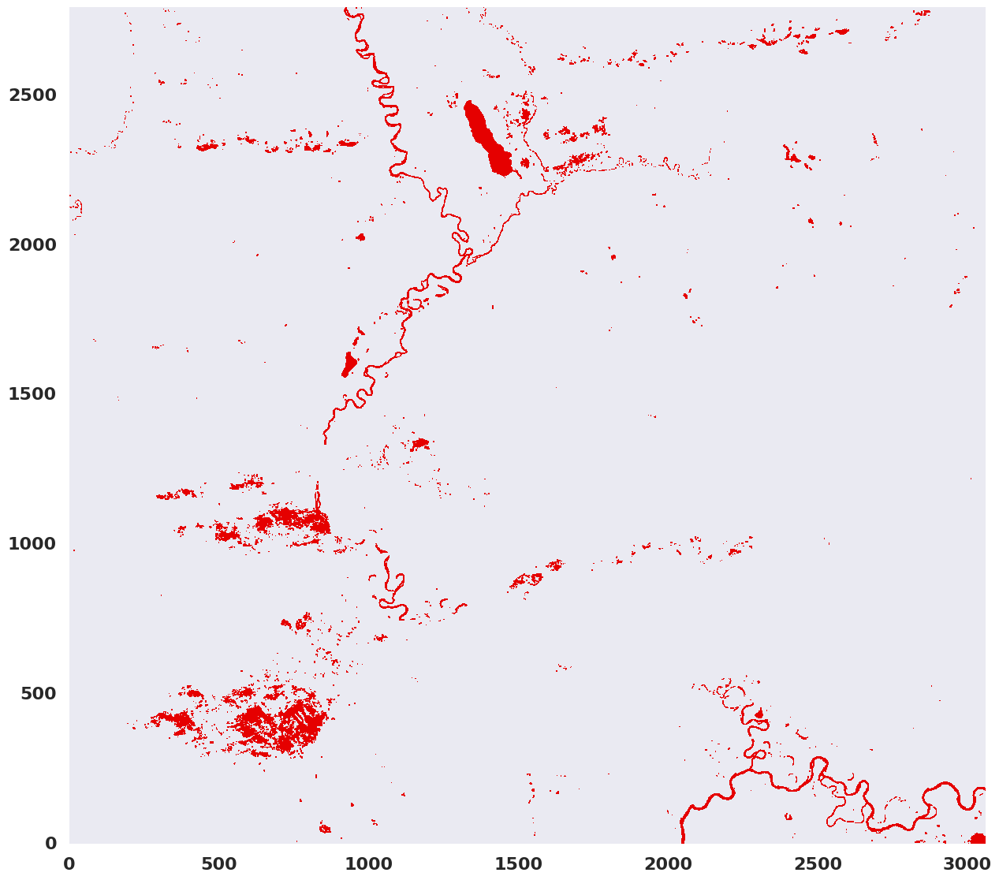

In [57]:
fig1 = plt.figure(1, figsize=(15, 15))
ax1 = fig1.add_subplot(111)
ax1.set_aspect('equal')
ax1.set_xlim((0, xmax))
ax1.set_ylim((0, ymax))
maskplot1 = ax1.pcolormesh(np.flipud(water_masked), cmap=cmap1, vmin=0, vmax=1)

## Option 1: NEW processing of L8 fire points

In [38]:
allfire, highfire, anomfire, lowfire = lfire.get_l8fire(landsat, debug=True, high_only=True)

Getting Landsat 8 reflectances
Getting unambiguous fires
There are 14392 unambiguous fires
Getting anomalous fires
There are 12 anomalous fires


In [42]:
sum(sum(highfire))

14392

In [39]:
sum(sum(allfire)) - sum(sum(highfire))

TypeError: unsupported operand type(s) for +: 'int' and 'NoneType'

In [43]:
allfire_masked = np.ma.masked_where(
        ~highfire, np.ones((ymax, xmax)))
highfire_masked = np.ma.masked_where(
        ~highfire, np.ones((ymax, xmax)))

Save data

In [61]:
outfns = ["2016_YK_L8_allfire.tif", "2016_YK_L8_highfire.tif", "2016_YK_L8_anomfire.tif"]
rasters = [allfire, highfire, anomfire]
for outfn, rst in zip(outfns, rasters):
    outpath = os.path.join(productdir, outfn)
    landsat.band7.clone(outpath, rst.data.astype('int8'))

INFO:pygaarst.geotiff:int8
INFO:pygaarst.geotiff:{'complex128': 11, 'uint32': 4, 'uint16': 2, 'float32': 6, 'complex64': 10, 'int32': 5, 'float64': 7, 'uint8': 1, 'int16': 3, 'int8': 1}
INFO:pygaarst.geotiff:1
INFO:pygaarst.geotiff:int8
INFO:pygaarst.geotiff:{'complex128': 11, 'uint32': 4, 'uint16': 2, 'float32': 6, 'complex64': 10, 'int32': 5, 'float64': 7, 'uint8': 1, 'int16': 3, 'int8': 1}
INFO:pygaarst.geotiff:1
INFO:pygaarst.geotiff:int8
INFO:pygaarst.geotiff:{'complex128': 11, 'uint32': 4, 'uint16': 2, 'float32': 6, 'complex64': 10, 'int32': 5, 'float64': 7, 'uint8': 1, 'int16': 3, 'int8': 1}
INFO:pygaarst.geotiff:1


## Option 2: LOAD L8 fire data from GeoTIFF files

In [14]:
fns = ["2016_YK_L8_allfire.tif", "2016_YK_L8_highfire.tif", "2016_YK_L8_anomfire.tif"]
rasterdir = '/Volumes/SCIENCE_mobile_Mac/Fire/DATA_BY_PROJECT/2015VIIRSMODIS/rasterout/'

In [15]:
loadallfire =  raster.GeoTIFF(os.path.join(rasterdir, fns[0]))
loadhighfire =  raster.GeoTIFF(os.path.join(rasterdir, fns[1]))
loadanomfire =  raster.GeoTIFF(os.path.join(rasterdir, fns[2]))

In [16]:
loadallfire.data

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ..., 
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8)

In [17]:
sum(sum(loadhighfire.data))

14392

In [18]:
allfire_masked = np.ma.masked_where(
        loadallfire.data == 0, np.ones((ymax, xmax)))
highfire_masked = np.ma.masked_where(
        loadhighfire.data == 0, np.ones((ymax, xmax)))
anomfire_masked = np.ma.masked_where(
        loadanomfire.data == 0, np.ones((ymax, xmax)))

## Raster testplots

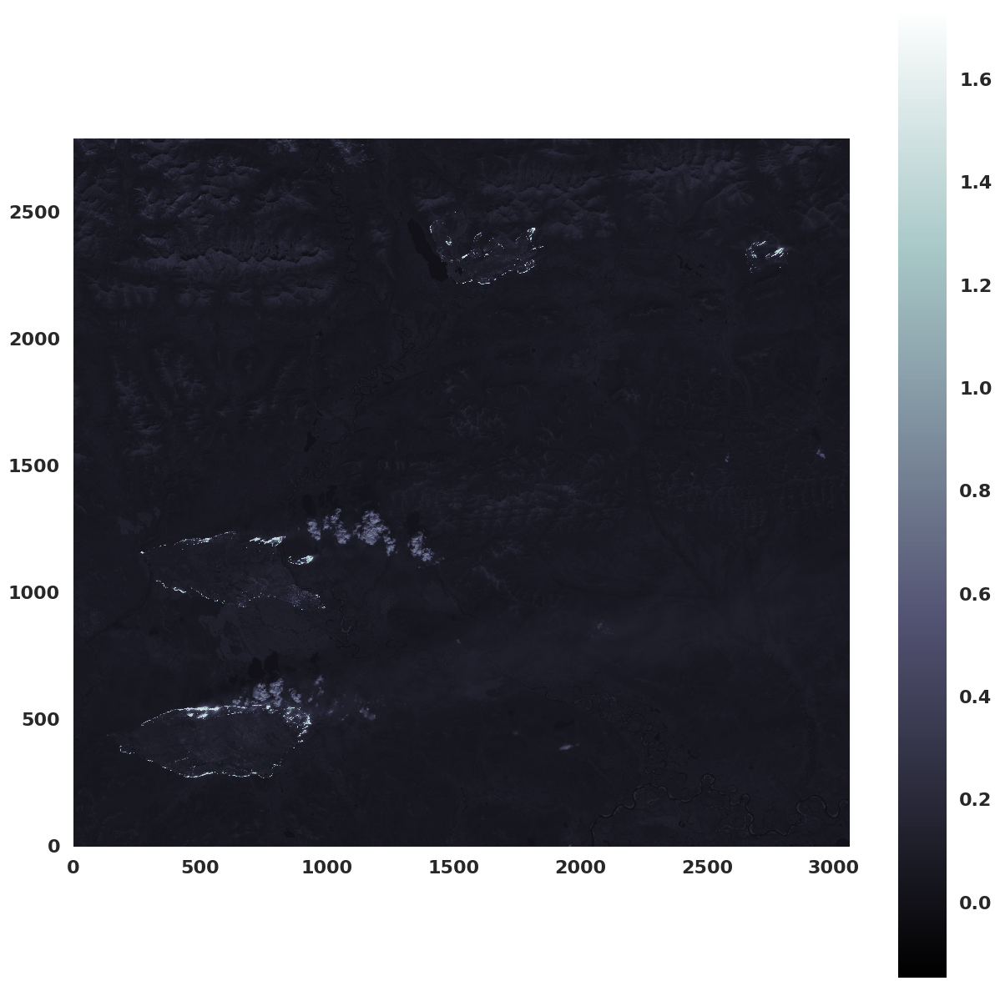

In [26]:
fig1 = plt.figure(1, figsize=(15, 15))
ax1 = fig1.add_subplot(111)
ax1.set_aspect('equal')
ax1.set_xlim((0, xmax))
ax1.set_ylim((0, ymax))
dataplot = ax1.pcolormesh(np.flipud(rho7))
cbar = fig1.colorbar(dataplot)

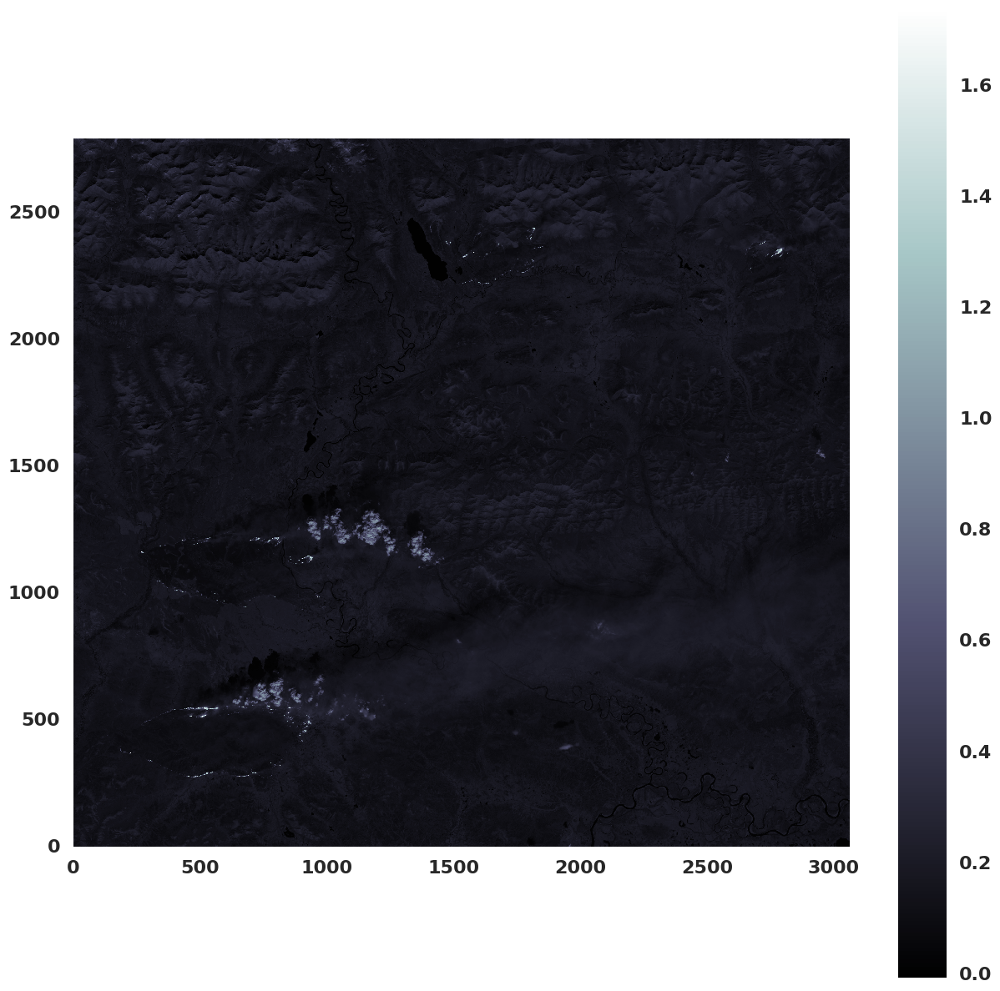

In [27]:
fig1 = plt.figure(1, figsize=(15, 15))
ax1 = fig1.add_subplot(111)
ax1.set_aspect('equal')
ax1.set_xlim((0, xmax))
ax1.set_ylim((0, ymax))
dataplot = ax1.pcolormesh(np.flipud(rho6))
cbar = fig1.colorbar(dataplot)

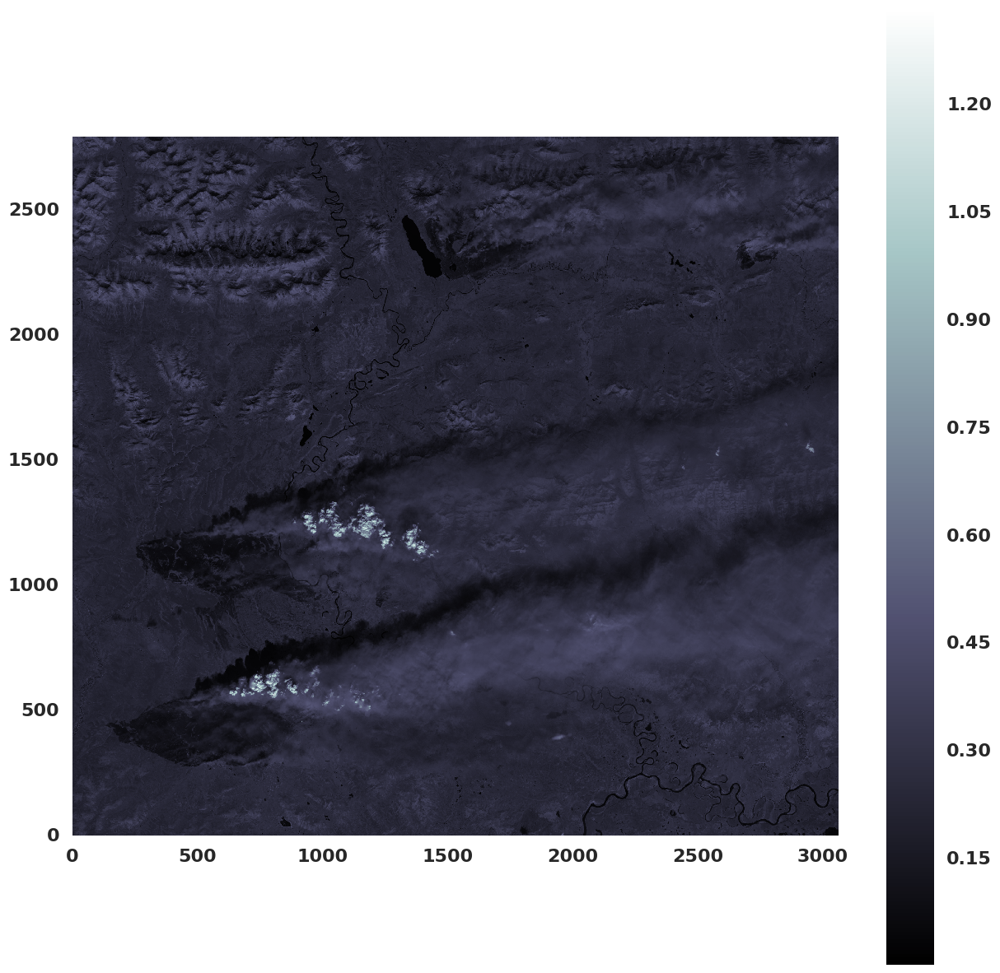

In [28]:
fig1 = plt.figure(1, figsize=(15, 15))
ax1 = fig1.add_subplot(111)
ax1.set_aspect('equal')
ax1.set_xlim((0, xmax))
ax1.set_ylim((0, ymax))
dataplot = ax1.pcolormesh(np.flipud(rho5))
cbar = fig1.colorbar(dataplot)

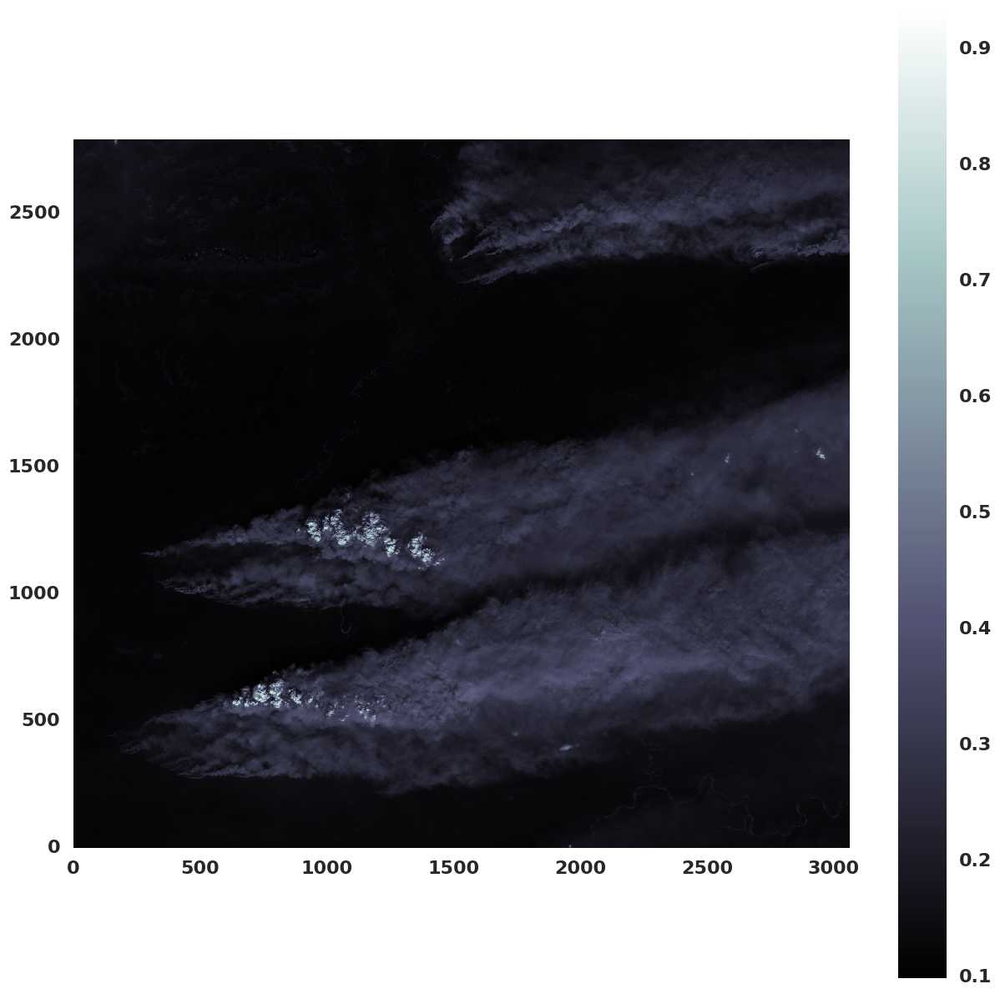

In [29]:
fig1 = plt.figure(1, figsize=(15, 15))
ax1 = fig1.add_subplot(111)
ax1.set_aspect('equal')
ax1.set_xlim((0, xmax))
ax1.set_ylim((0, ymax))
dataplot = ax1.pcolormesh(np.flipud(rho1))
cbar = fig1.colorbar(dataplot)

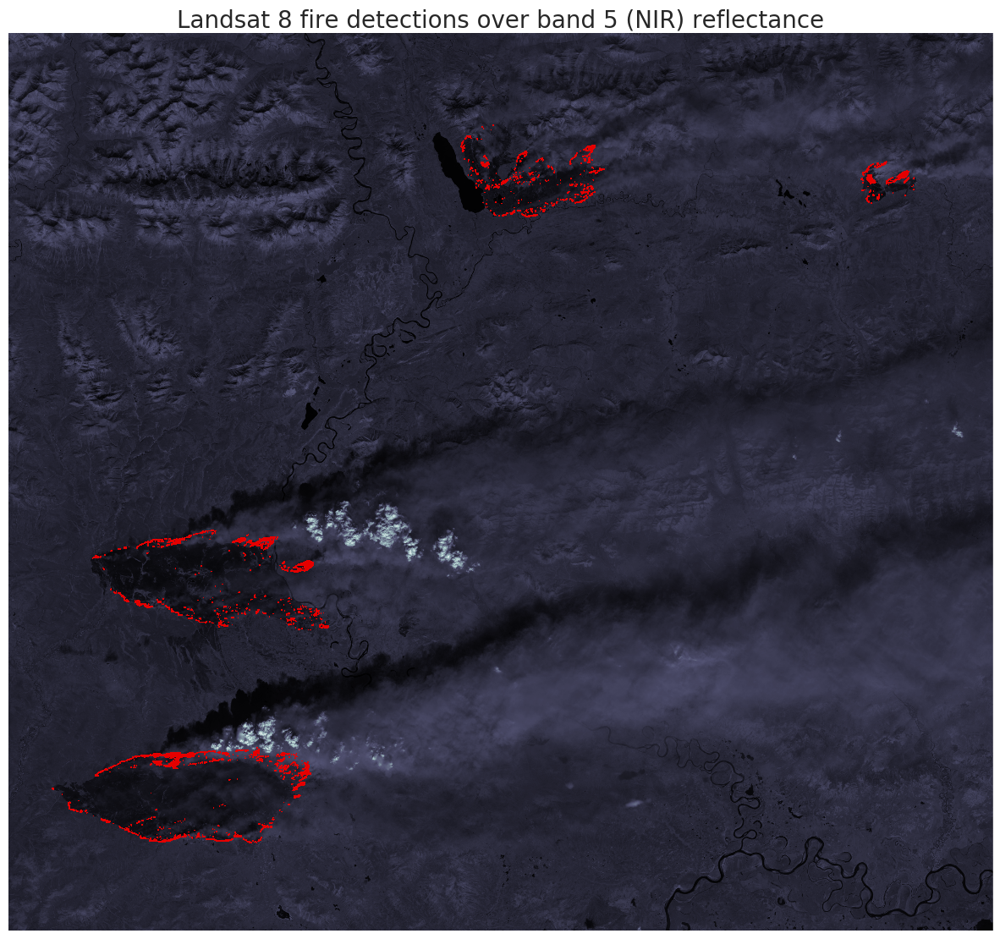

In [53]:
fig1 = plt.figure(1, figsize=(15, 15))
ax1 = fig1.add_subplot(111)
ax1.set_aspect('equal')
ax1.set_xlim((0, xmax))
ax1.set_ylim((0, ymax))
ax1.set_xticklabels([])
ax1.set_yticklabels([])
ax1.set_title("Landsat 8 fire detections over band 5 (NIR) reflectance")
dataplot = ax1.imshow(np.flipud(rho5))
maskplot1 = ax1.pcolormesh(np.flipud(allfire_masked2), cmap=cmap1, vmin=0, vmax=1)

In [31]:
outfn = '2016_YK_landsatB5_firemask2.png'
#fig1.savefig(os.path.join(productdir, outfn), dpi=200, bb_inches='tight')
fig1.savefig(os.path.join(productdir, outfn))

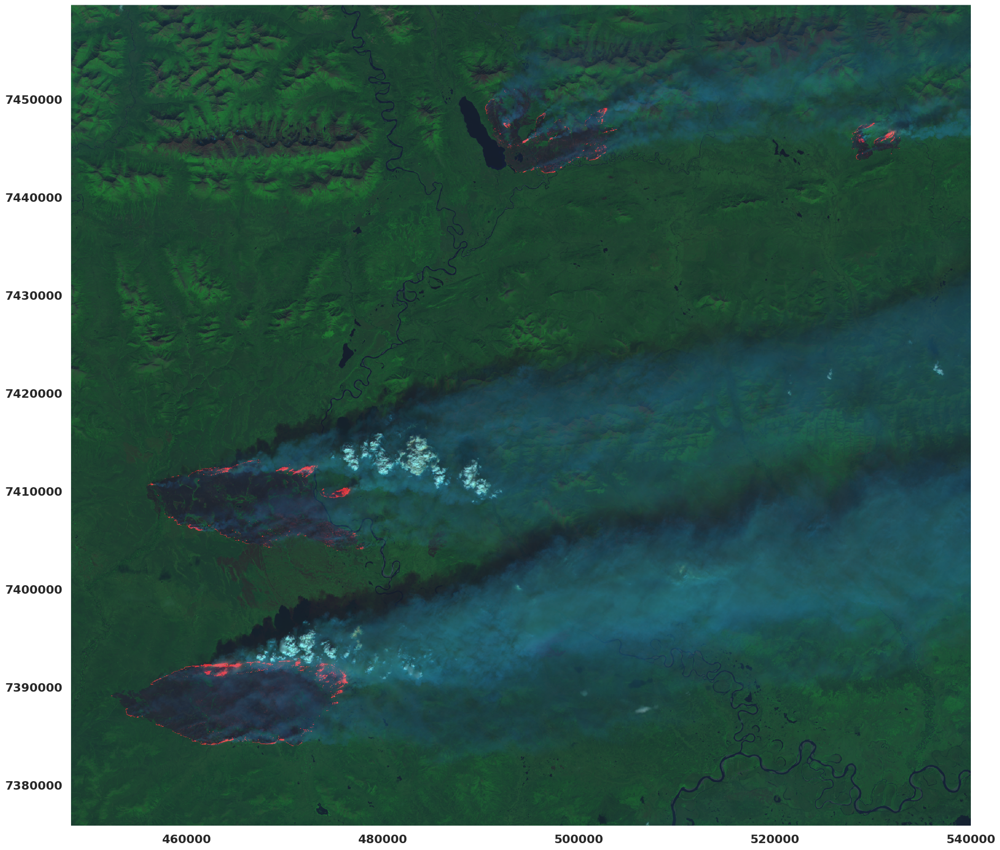

In [76]:
fig1 = plt.figure(1, figsize=(25, 20))
ax1 = fig1.add_subplot(111)
ax1.set_aspect('equal')
X, Y =  landsat.band5._XY
Y = np.flipud(Y)
ax1.set_xlim((X[0][0], X[0, -1]))
ax1.set_ylim((Y[0][0], Y[-1, 0]))
#ax1.set_xlim((465500, 495000))
#ax1.set_ylim((7225000 , 7195000))
ax1.invert_yaxis()
ax1.grid(False)
ax1.set_aspect('equal')
dataplot = ax1.imshow(np.flipud(rgb764), extent=[X[0][0], X[0, -1], Y[0][0], Y[-1, 0]], interpolation='none')

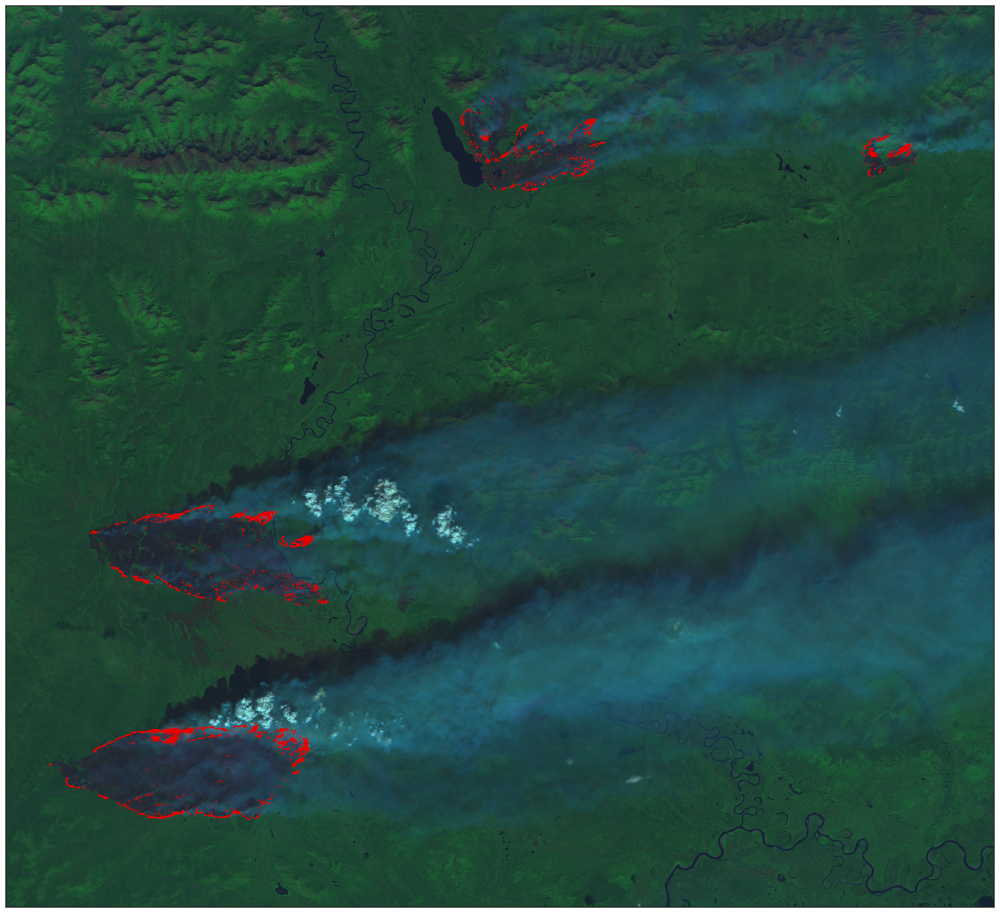

In [45]:
fig1 = plt.figure(1, figsize=(25, 20))
ax1 = fig1.add_subplot(111)
ax1.set_aspect('equal')
X, Y =  landsat.band5._XY
Y = np.flipud(Y)
ax1.set_xlim((X[0][0], X[0, -1]))
ax1.set_ylim((Y[0][0], Y[-1, 0]))
#ax1.set_xlim((465500, 495000))
#ax1.set_ylim((7225000 , 7195000))
ax1.invert_yaxis()
ax1.grid(False)
ax1.set_aspect('equal')
ax1.set_xticklabels([])
ax1.set_yticklabels([])
#ax1.set_title("High (yellow) and low (grey) intensity VIIRS fire detections over Landsat (red)")
dataplot = ax1.imshow(np.flipud(rgb753), extent=[X[0][0], X[0, -1], Y[0][0], Y[-1, 0]], interpolation='none')
#patches = [PolygonPatch(poly, facecolor=(0, 0.55, 0.45, 0.25), edgecolor='lightgrey', lw=3) for poly in firepolygons_l]
#ax1.add_collection(PatchCollection(patches, match_original=True))
#patches = [PolygonPatch(poly, facecolor=(1, 0.35, 0, 0.25), edgecolor='yellow', lw=3) for poly in firepolygons_h]
#ax1.add_collection(PatchCollection(patches, match_original=True))
maskplot1 = ax1.pcolormesh(X, Y, allfire_masked, cmap=cmap1, vmin=0, vmax=1)
#maskplot2 = ax1.pcolormesh(X, Y, highfire_masked, cmap=cmap1, vmin=0, vmax=1)

In [136]:
landsat.meta['PRODUCT_METADATA']['DATE_ACQUIRED'], landsat.meta['PRODUCT_METADATA']['SCENE_CENTER_TIME']

(datetime.date(2016, 7, 15), datetime.time(21, 43, 4, 901277))

In [19]:
newviirspolydf.GMT.values

array([u'2058', u'2058', u'2058', ..., u'2241', u'2241', u'2241'], dtype=object)

### Early scene

In [20]:
crs = from_string(landsat.band7.proj4)
samplerecords = newviirspolydf.loc[
    (newviirspolydf['DATE'] == '2016-07-15')
    & (newviirspolydf['GMT'] == '2058')
    & (newviirspolydf['LAT'] < 68.0)
    & (newviirspolydf['LAT'] > 64.8)]
samplerecords = samplerecords.drop_duplicates(subset=['LAT', 'LON', 'DATE', 'GMT'])
firepolygons_h = samplerecords[(samplerecords['Type'] != 'L')]['geometry'].to_crs(crs)
firepolygons_l = samplerecords[(samplerecords['Type'] == 'L')]['geometry'].to_crs(crs)

In [21]:
samplerecords.shape

(846, 14)

In [22]:
firepolygons_h.shape

(458,)

In [23]:
firepolygons_l.shape 

(388,)

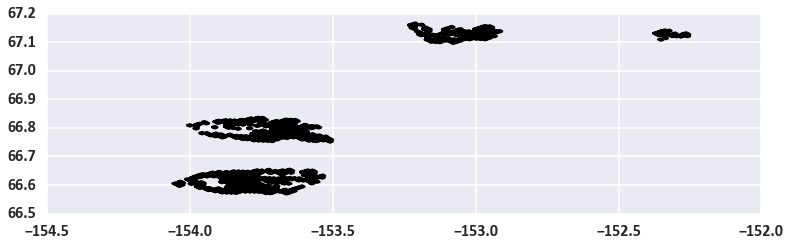

In [19]:
samplerecords['geometry'].plot()

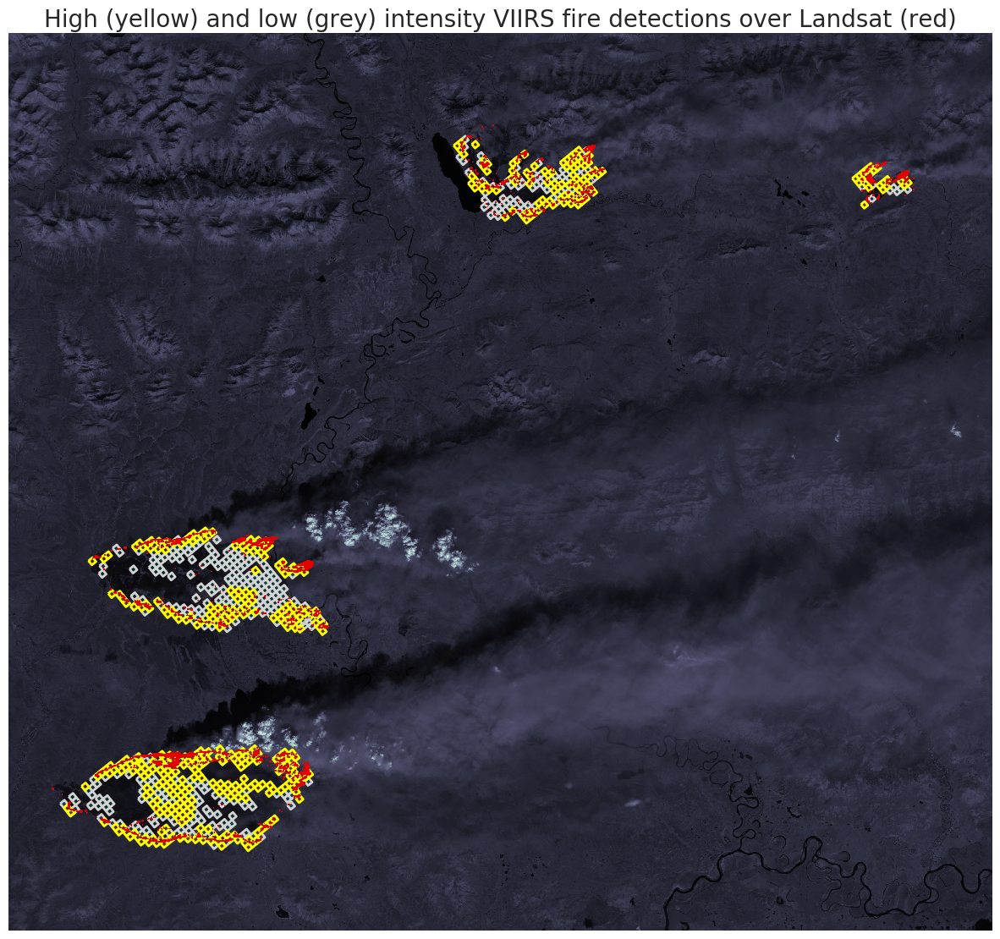

In [30]:
fig1 = plt.figure(1, figsize=(15, 15))
ax1 = fig1.add_subplot(111)
ax1.set_aspect('equal')
X, Y =  landsat.band5._XY
Y = np.flipud(Y)
ax1.set_xlim((X[0][0], X[0, -1]))
ax1.set_ylim((Y[0][0], Y[-1, 0]))
ax1.set_xticklabels([])
ax1.set_yticklabels([])
ax1.invert_yaxis()
ax1.set_title("High (yellow) and low (grey) intensity VIIRS fire detections over Landsat (red)")
dataplot = ax1.pcolormesh(X, Y, rho5)
patches = [PolygonPatch(poly, facecolor=(0, 0.55, 0.45, 0.25), edgecolor='lightgrey', lw=2) for poly in firepolygons_l]
ax1.add_collection(PatchCollection(patches, match_original=True))
patches = [PolygonPatch(poly, facecolor=(1, 0.35, 0, 0.25), edgecolor='yellow', lw=2) for poly in firepolygons_h]
ax1.add_collection(PatchCollection(patches, match_original=True))
maskplot1 = ax1.pcolormesh(X, Y, allfire_masked, cmap=cmap1, vmin=0, vmax=1)

In [31]:
outfn = '2016_YK_landsat_firemask_footprints.png'
fig1.savefig(os.path.join(productdir, outfn), dpi=200, bb_inches='tight')

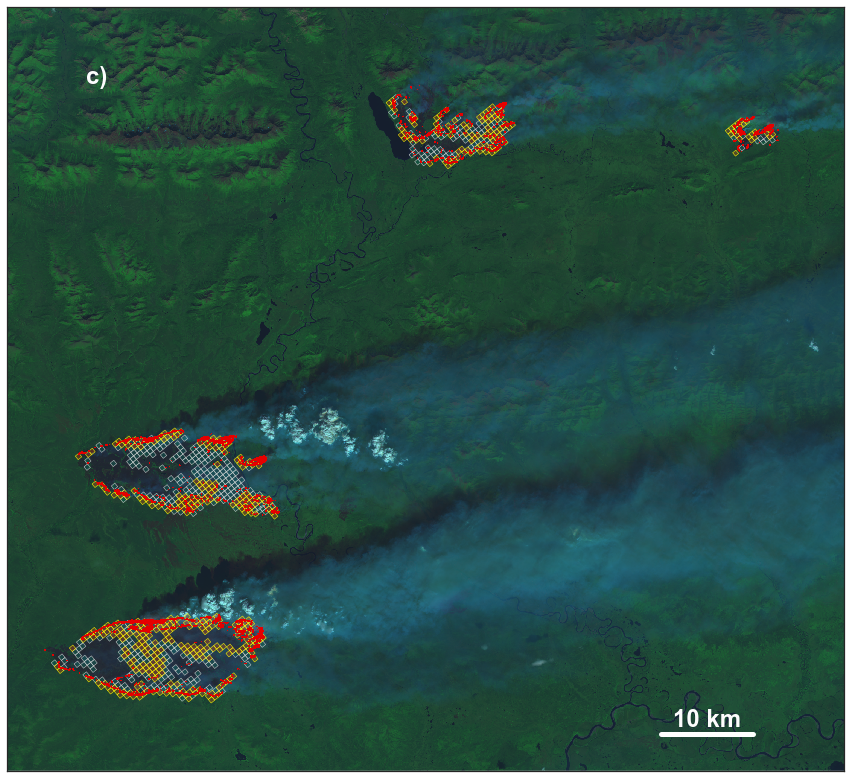

In [26]:
sns.set_style('white')

fig1 = plt.figure(1, figsize=(15, 15))
ax1 = fig1.add_subplot(111)
ax1.set_aspect('equal')
X, Y =  landsat.band5._XY
Y = np.flipud(Y)
ax1.set_xlim((X[0][0], X[0, -1]))
ax1.set_ylim((Y[0][0], Y[-1, 0]))
#ax1.set_xlim((465500, 495000))
#ax1.set_ylim((7225000 , 7195000))
ax1.set_xticklabels([])
ax1.set_yticklabels([])
ax1.invert_yaxis()
#ax1.set_title("High (yellow) and low (grey) intensity VIIRS fire detections over Landsat (red)")
dataplot = ax1.imshow(np.flipud(rgb753), extent=[X[0][0], X[0, -1], Y[0][0], Y[-1, 0]], interpolation='none')
patches1 = [PolygonPatch(poly, facecolor=(0, 0.55, 0.45, 0.25), edgecolor='lightgrey', lw=.5) for poly in firepolygons_l]
ax1.add_collection(PatchCollection(patches1, match_original=True))
patches2 = [PolygonPatch(poly, facecolor=(1, 0.35, 0, 0.25), edgecolor='yellow', lw=.5) for poly in firepolygons_h]
ax1.add_collection(PatchCollection(patches2, match_original=True))
maskplot1 = ax1.pcolormesh(X, Y, allfire_masked, cmap=cmap1, vmin=0, vmax=1)
#scale bar
ax1.plot([520000, 530000], [7380000, 7380000], color='w', lw=5)
ax1.text(525000, 7381500, 
         '10 km', 
          ha="center", va="center", 
          color='w', size=24)
ax1.text(458000, 7452000, 
         'c)', 
          ha="center", va="center", 
          color='w', size=24)



In [27]:
outfn = 'Fig08c.png'
fig1.savefig(os.path.join(productdir, outfn), dpi=300, bb_inches='tight')

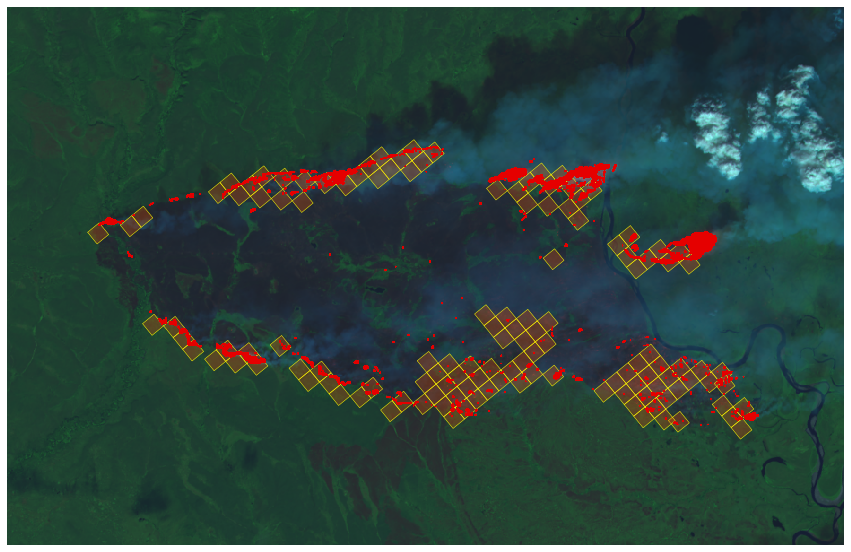

In [36]:
fig1 = plt.figure(1, figsize=(15, 15))
ax1 = fig1.add_subplot(111)
ax1.set_aspect('equal')
X, Y =  landsat.band5._XY
Y = np.flipud(Y)
ax1.set_xlim((453000, 481000))
ax1.set_ylim((7418000 , 7400000))
ax1.set_xticklabels([])
ax1.set_yticklabels([])
ax1.invert_yaxis()
#ax1.set_title("High (yellow) and low (grey) intensity VIIRS fire detections over Landsat (red)")
dataplot = ax1.imshow(np.flipud(rgb753), extent=[X[0][0], X[0, -1], Y[0][0], Y[-1, 0]], interpolation='none')
#patches1 = [PolygonPatch(poly, facecolor=(0, 0.55, 0.45, 0.25), edgecolor='lightgrey', lw=.5) for poly in firepolygons_l]
#ax1.add_collection(PatchCollection(patches1, match_original=True))
patches2 = [PolygonPatch(poly, facecolor=(1, 0.35, 0, 0.25), edgecolor='yellow', lw=.5) for poly in firepolygons_h]
ax1.add_collection(PatchCollection(patches2, match_original=True))
maskplot1 = ax1.pcolormesh(X, Y, allfire_masked, cmap=cmap1, vmin=0, vmax=1)
#patches2 = [PolygonPatch(poly, facecolor=(.1, 0.1, 0.1, .95), edgecolor='darkgrey', lw=.5) for poly in firepolygons_h]
#ax1.add_collection(PatchCollection(patches2, match_original=True))


### Later scene

In [38]:
crs = from_string(landsat.band7.proj4)
samplerecords = newviirspolydf.loc[
    (newviirspolydf['DATE'] == '2016-07-15')
    & (newviirspolydf['GMT'] == '2241')
    & (newviirspolydf['LAT'] < 68.0)
    & (newviirspolydf['LAT'] > 64.8)]
samplerecords = samplerecords.drop_duplicates(subset=['LAT', 'LON', 'DATE', 'GMT'])
firepolygons_h_2 = samplerecords[(samplerecords['Type'] != 'L')]['geometry'].to_crs(crs)
firepolygons_l_2 = samplerecords[(samplerecords['Type'] == 'L')]['geometry'].to_crs(crs)

In [39]:
samplerecords.shape

(1934, 14)

In [40]:
firepolygons_h_2.shape

(1143,)

In [41]:
firepolygons_l_2.shape

(791,)

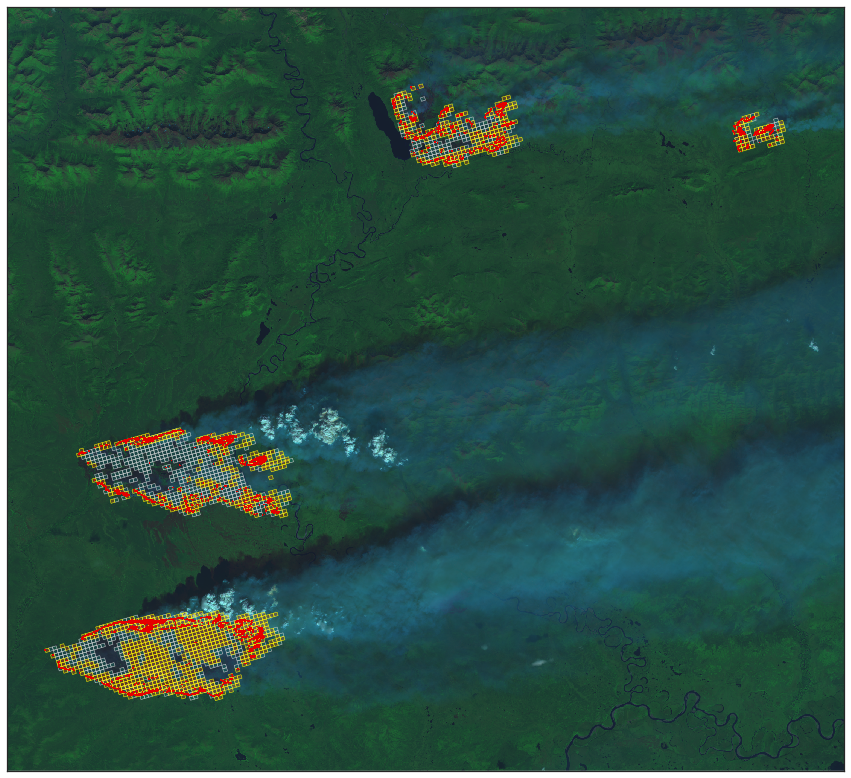

In [192]:
sns.set_style('white')

fig1 = plt.figure(1, figsize=(15, 15))
ax1 = fig1.add_subplot(111)
ax1.set_aspect('equal')
X, Y =  landsat.band5._XY
Y = np.flipud(Y)
ax1.set_xlim((X[0][0], X[0, -1]))
ax1.set_ylim((Y[0][0], Y[-1, 0]))
#ax1.set_xlim((465500, 495000))
#ax1.set_ylim((7225000 , 7195000))
ax1.set_xticklabels([])
ax1.set_yticklabels([])
ax1.invert_yaxis()
#ax1.set_title("High (yellow) and low (grey) intensity VIIRS fire detections over Landsat (red)")
dataplot = ax1.imshow(np.flipud(rgb753), extent=[X[0][0], X[0, -1], Y[0][0], Y[-1, 0]], interpolation='none')
patches1 = [PolygonPatch(poly, facecolor=(0, 0.55, 0.45, 0.25), edgecolor='lightgrey', lw=.5) for poly in firepolygons_l_2]
ax1.add_collection(PatchCollection(patches1, match_original=True))
patches2 = [PolygonPatch(poly, facecolor=(1, 0.35, 0, 0.25), edgecolor='yellow', lw=.5) for poly in firepolygons_h_2]
ax1.add_collection(PatchCollection(patches2, match_original=True))
maskplot1 = ax1.pcolormesh(X, Y, allfire_masked, cmap=cmap1, vmin=0, vmax=1)

In [129]:
outfn = '2016_YK_landsat_firemask_footprints_2241.png'
fig1.savefig(os.path.join(productdir, outfn), dpi=400, bb_inches='tight')

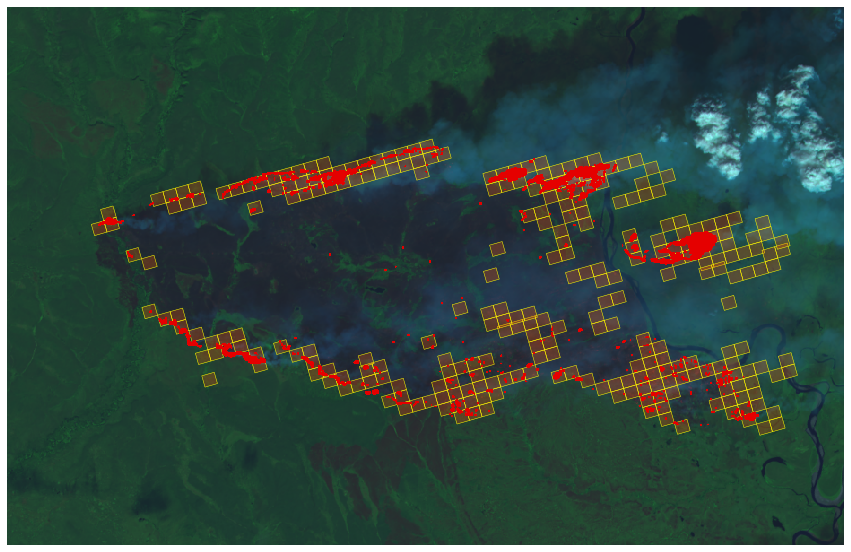

In [24]:
fig1 = plt.figure(1, figsize=(15, 15))
ax1 = fig1.add_subplot(111)
ax1.set_aspect('equal')
X, Y =  landsat.band5._XY
Y = np.flipud(Y)
ax1.set_xlim((453000, 481000))
ax1.set_ylim((7418000 , 7400000))
ax1.set_xticklabels([])
ax1.set_yticklabels([])
ax1.invert_yaxis()
#ax1.set_title("High (yellow) and low (grey) intensity VIIRS fire detections over Landsat (red)")
dataplot = ax1.imshow(np.flipud(rgb753), extent=[X[0][0], X[0, -1], Y[0][0], Y[-1, 0]], interpolation='none')
#patches1 = [PolygonPatch(poly, facecolor=(0, 0.55, 0.45, 0.25), edgecolor='lightgrey', lw=.5) for poly in firepolygons_l_2]
#ax1.add_collection(PatchCollection(patches1, match_original=True))
patches2 = [PolygonPatch(poly, facecolor=(1, 0.35, 0, 0.25), edgecolor='yellow', lw=.5) for poly in firepolygons_h_2]
ax1.add_collection(PatchCollection(patches2, match_original=True))
maskplot1 = ax1.pcolormesh(X, Y, allfire_masked, cmap=cmap1, vmin=0, vmax=1)


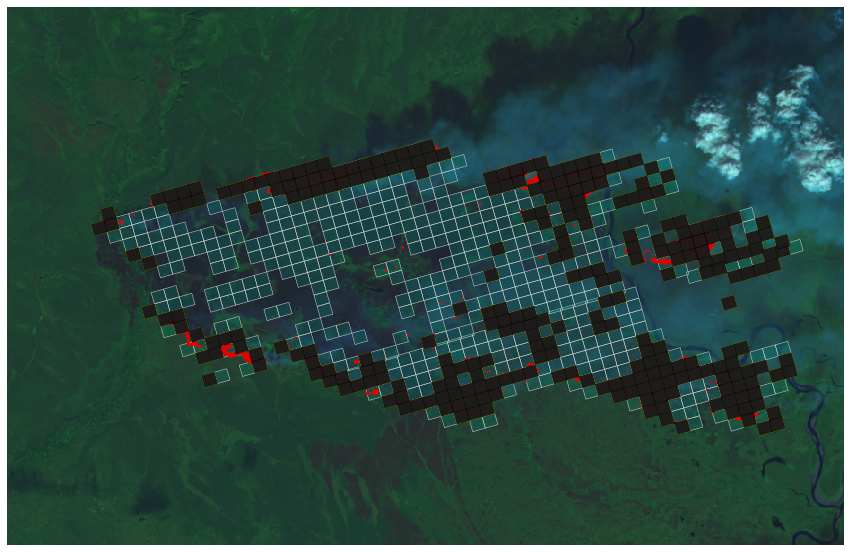

In [44]:
fig1 = plt.figure(1, figsize=(15, 15))
ax1 = fig1.add_subplot(111)
ax1.set_aspect('equal')
X, Y =  landsat.band5._XY
Y = np.flipud(Y)
ax1.set_xlim((453000, 481000))
ax1.set_ylim((7418000 , 7400000))
ax1.set_xticklabels([])
ax1.set_yticklabels([])
ax1.invert_yaxis()
#ax1.set_title("High (yellow) and low (grey) intensity VIIRS fire detections over Landsat (red)")
dataplot = ax1.imshow(np.flipud(rgb753), extent=[X[0][0], X[0, -1], Y[0][0], Y[-1, 0]], interpolation='none')
patches1 = [PolygonPatch(poly, facecolor=(0, 0.55, 0.45, 0.25), edgecolor='lightgrey', lw=.5) for poly in firepolygons_l_2]
ax1.add_collection(PatchCollection(patches1, match_original=True))
patches2 = [PolygonPatch(poly, facecolor=(1, 0.35, 0, 0.25), edgecolor='yellow', lw=.5) for poly in firepolygons_h_2]
ax1.add_collection(PatchCollection(patches2, match_original=True))
maskplot1 = ax1.pcolormesh(X, Y, allfire_masked, cmap=cmap1, vmin=0, vmax=1)
patches2 = [PolygonPatch(poly, facecolor=(.1, 0.1, 0.1, .95), edgecolor='black', lw=.5) for poly in firepolygons_h_2]
ax1.add_collection(PatchCollection(patches2, match_original=True))


## Now with official product

In [25]:
firehotspots = "/Volumes/SCIENCE_mobile_Mac/Fire/DATA_BY_PROJECT/2015VIIRSMODIS/FIRMS/"
viirsIdir = "DL_FIRE_V1_7321"
viirsIshp = "fire_nrt_V1_7321.shp"
viirsIDF = gp.GeoDataFrame.from_file(os.path.join(firehotspots, viirsIdir, viirsIshp))
ullat = 67.25
ullon = -154.8
lrlat = 66.5
lrlon = -152.0

In [26]:
testviirsDF = viirsIDF[(viirsIDF.LATITUDE < ullat) & (viirsIDF.LATITUDE > lrlat)
        & (viirsIDF.LONGITUDE < lrlon) & (viirsIDF.LONGITUDE > ullon)]
testviirsDF_1 = testviirsDF.loc[(testviirsDF['ACQ_DATE'] == '2016-07-15') & (testviirsDF['ACQ_TIME'] == '2100')]
testviirsDF_2 = testviirsDF.loc[(testviirsDF['ACQ_DATE'] == '2016-07-15') & (testviirsDF['ACQ_TIME'] == '2240')]

In [27]:
testviirsDF_1.ACQ_TIME.value_counts()

2100    440
Name: ACQ_TIME, dtype: int64

In [28]:
testviirsDF_2.ACQ_TIME.value_counts()

2240    1006
Name: ACQ_TIME, dtype: int64

In [157]:
from functools import partial
from shapely.geometry import box, Point

In [163]:
side = 375.0
def makebox(point, a=100.0, b=None):
    if not b: 
        b=a
    return box((point.x)-a/2, point.y-b/2, point.x+a/2, point.y+b/2)

makeboxes = partial(makebox, a=side)

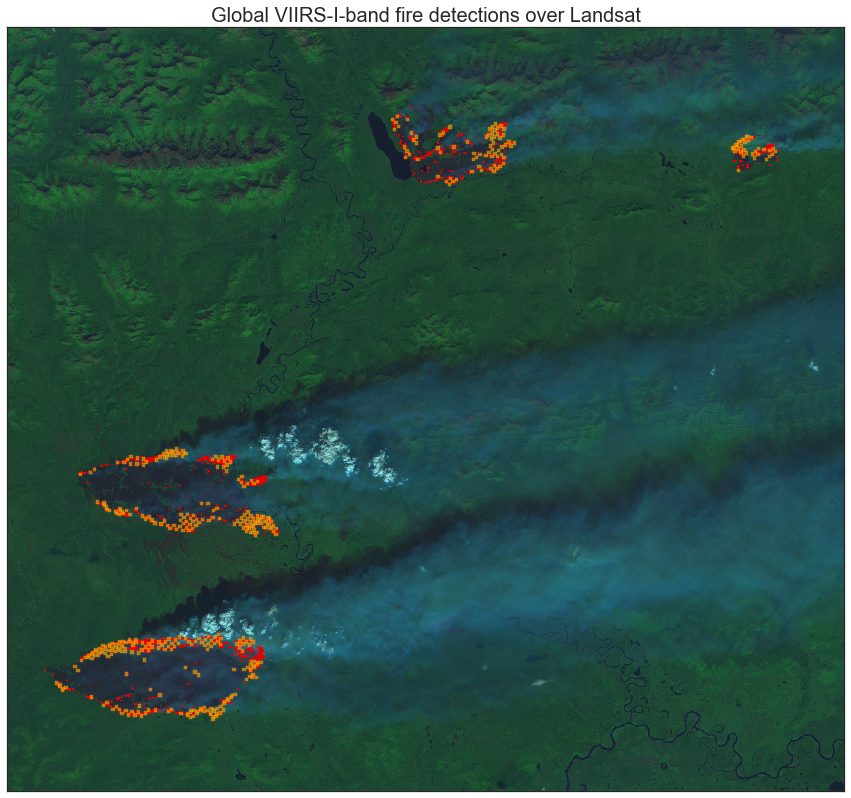

In [201]:
fig1 = plt.figure(1, figsize=(15, 15))
ax1 = fig1.add_subplot(111)
ax1.set_aspect('equal')
X, Y =  landsat.band5._XY
Y = np.flipud(Y)
ax1.set_xlim((X[0][0], X[0, -1]))
ax1.set_ylim((Y[0][0], Y[-1, 0]))
ax1.set_xticklabels([])
ax1.set_yticklabels([])
ax1.invert_yaxis()
#ax1.set_title("High (yellow) and low (grey) intensity VIIRS fire detections over Landsat (red)")
dataplot = ax1.imshow(np.flipud(rgb753), extent=[X[0][0], X[0, -1], Y[0][0], Y[-1, 0]], interpolation='none')

ax1.set_title("Global VIIRS-I-band fire detections over Landsat")
dataplot = ax1.imshow(np.flipud(rgb753), extent=[X[0][0], X[0, -1], Y[0][0], Y[-1, 0]], interpolation='none')
maskplot1 = ax1.pcolormesh(X, Y, allfire_masked, cmap=cmap1, vmin=0, vmax=1)

boxseries = gp.GeoSeries(map(makeboxes, testviirsDF_1.geometry.to_crs(crs).values))
boxseries.crs = testviirsdf.crs
patches = [PolygonPatch(poly, color='orange', alpha=0.6) for poly in boxseries]

if patches:
    ax1.add_collection(PatchCollection(patches, match_original=True))


In [202]:
outfn = '2016_YK_landsat_firemask_I-band_footprints_2058.png'
fig1.savefig(os.path.join(productdir, outfn), dpi=400, bb_inches='tight')

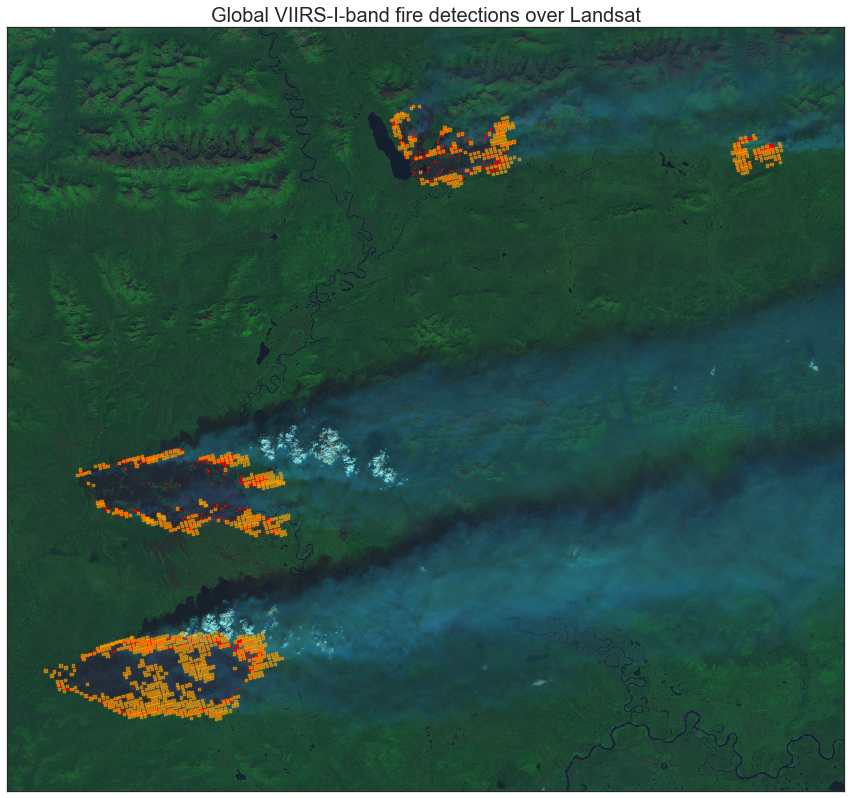

In [206]:
fig1 = plt.figure(1, figsize=(15, 15))
ax1 = fig1.add_subplot(111)
ax1.set_aspect('equal')
X, Y =  landsat.band5._XY
Y = np.flipud(Y)
ax1.set_xlim((X[0][0], X[0, -1]))
ax1.set_ylim((Y[0][0], Y[-1, 0]))
ax1.set_xticklabels([])
ax1.set_yticklabels([])
ax1.invert_yaxis()
#ax1.set_title("High (yellow) and low (grey) intensity VIIRS fire detections over Landsat (red)")
dataplot = ax1.imshow(np.flipud(rgb753), extent=[X[0][0], X[0, -1], Y[0][0], Y[-1, 0]], interpolation='none')

ax1.set_title("Global VIIRS-I-band fire detections over Landsat")
dataplot = ax1.imshow(np.flipud(rgb753), extent=[X[0][0], X[0, -1], Y[0][0], Y[-1, 0]], interpolation='none')
maskplot1 = ax1.pcolormesh(X, Y, allfire_masked, cmap=cmap1, vmin=0, vmax=1)

boxseries = gp.GeoSeries(map(makeboxes, testviirsDF_2.geometry.to_crs(crs).values))
boxseries.crs = testviirsdf.crs
patches = [PolygonPatch(poly, color='orange', alpha=0.6) for poly in boxseries]

if patches:
    ax1.add_collection(PatchCollection(patches, match_original=True))


In [204]:
outfn = '2016_YK_landsat_firemask_I-band_footprints_2241.png'
fig1.savefig(os.path.join(productdir, outfn), dpi=400, bb_inches='tight')

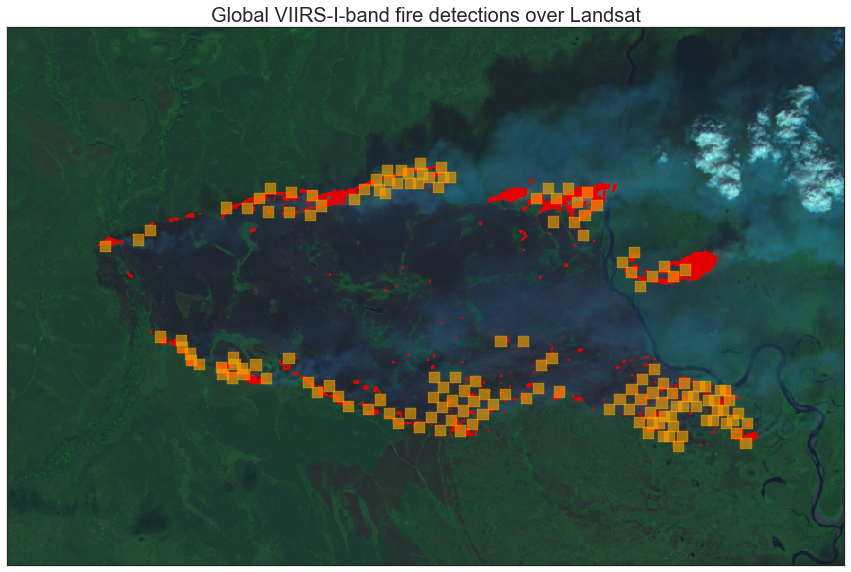

In [209]:
fig1 = plt.figure(1, figsize=(15, 15))
ax1 = fig1.add_subplot(111)
ax1.set_aspect('equal')
X, Y =  landsat.band5._XY
Y = np.flipud(Y)
ax1.set_xlim((453000, 481000))
ax1.set_ylim((7418000 , 7400000))
ax1.set_xticklabels([])
ax1.set_yticklabels([])
ax1.invert_yaxis()
dataplot = ax1.imshow(np.flipud(rgb753), extent=[X[0][0], X[0, -1], Y[0][0], Y[-1, 0]], interpolation='none')

ax1.set_title("Global VIIRS-I-band fire detections over Landsat")
dataplot = ax1.imshow(np.flipud(rgb753), extent=[X[0][0], X[0, -1], Y[0][0], Y[-1, 0]], interpolation='none')
maskplot1 = ax1.pcolormesh(X, Y, allfire_masked, cmap=cmap1, vmin=0, vmax=1)

boxseries = gp.GeoSeries(map(makeboxes, testviirsDF_1.geometry.to_crs(crs).values))
boxseries.crs = testviirsdf.crs
patches = [PolygonPatch(poly, color='orange', alpha=0.6) for poly in boxseries]

if patches:
    ax1.add_collection(PatchCollection(patches, match_original=True))


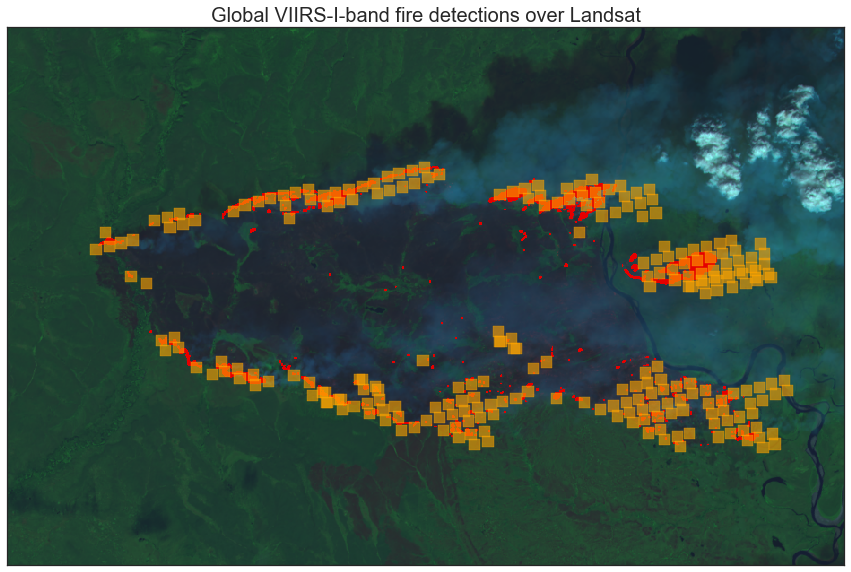

In [210]:
fig1 = plt.figure(1, figsize=(15, 15))
ax1 = fig1.add_subplot(111)
ax1.set_aspect('equal')
X, Y =  landsat.band5._XY
Y = np.flipud(Y)
ax1.set_xlim((453000, 481000))
ax1.set_ylim((7418000 , 7400000))
ax1.set_xticklabels([])
ax1.set_yticklabels([])
ax1.invert_yaxis()
dataplot = ax1.imshow(np.flipud(rgb753), extent=[X[0][0], X[0, -1], Y[0][0], Y[-1, 0]], interpolation='none')

ax1.set_title("Global VIIRS-I-band fire detections over Landsat")
dataplot = ax1.imshow(np.flipud(rgb753), extent=[X[0][0], X[0, -1], Y[0][0], Y[-1, 0]], interpolation='none')
maskplot1 = ax1.pcolormesh(X, Y, allfire_masked, cmap=cmap1, vmin=0, vmax=1)

boxseries = gp.GeoSeries(map(makeboxes, testviirsDF_2.geometry.to_crs(crs).values))
boxseries.crs = testviirsdf.crs
patches = [PolygonPatch(poly, color='orange', alpha=0.6) for poly in boxseries]

if patches:
    ax1.add_collection(PatchCollection(patches, match_original=True))


## Statistics

In [26]:
samplerecords.drop_duplicates(subset=['LAT', 'LON', 'DATE', 'GMT']).to_crs(crs)

,AscNode,Bands,DATE,GMT,LAT,LON,Platform,SatZenithA,Sensor,SolZenithA,TB4,TB5,Type,geometry
896,Y,I-Bands,2016-07-15,2241,66.578163,-153.663391,NPP,19.174265,VIIRS,45.383804,367.000000,309.192688,A,"POLYGON ((470310.9975413813 7384642.042292364,..."
897,Y,I-Bands,2016-07-15,2241,66.589302,-153.599945,NPP,19.388750,VIIRS,45.398003,367.000000,300.501923,A,"POLYGON ((473137.0578056594 7385854.92622443, ..."
898,Y,I-Bands,2016-07-15,2241,66.580437,-153.675339,NPP,19.143261,VIIRS,45.385471,367.000000,307.307831,A,"POLYGON ((469784.5265378018 7384900.76550437, ..."
899,Y,I-Bands,2016-07-15,2241,66.586037,-153.659027,NPP,19.204353,VIIRS,45.391830,367.000000,302.165649,A,"POLYGON ((470514.2389892761 7385517.602949681,..."
900,Y,I-Bands,2016-07-15,2241,66.584923,-153.668442,NPP,19.173668,VIIRS,45.390266,367.000000,303.910156,A,"POLYGON ((470095.4647206302 7385397.919503146,..."
901,Y,I-Bands,2016-07-15,2241,66.580536,-153.736755,NPP,18.958670,VIIRS,45.382553,367.000000,307.479797,A,"POLYGON ((467061.268444533 7384942.452319385, ..."
902,Y,I-Bands,2016-07-15,2241,66.579422,-153.746140,NPP,18.928001,VIIRS,45.380997,367.000000,310.407166,A,"POLYGON ((466643.6053468361 7384823.274580427,..."
903,Y,I-Bands,2016-07-15,2241,66.577202,-153.764877,NPP,18.866665,VIIRS,45.377876,367.000000,303.562653,A,"POLYGON ((465809.5331329824 7384585.941609454,..."
904,Y,I-Bands,2016-07-15,2241,66.588356,-153.701721,NPP,19.081190,VIIRS,45.392029,367.000000,309.259399,A,"POLYGON ((468624.5125127356 7385796.50980386, ..."
905,Y,I-Bands,2016-07-15,2241,66.582794,-153.748657,NPP,18.927807,VIIRS,45.384224,367.000000,303.246765,A,"POLYGON ((466536.4887412336 7385200.50209176, ..."


In [32]:
firecond1idx = (ymax - np.where(allfire)[0], np.where(allfire)[1])
firecond1idx

(array([1219, 1219, 1219, 1218, 1218, 1217, 1216, 1215, 1215, 1214, 1214,
        1213, 1213, 1212, 1212, 1208, 1208, 1207, 1207, 1207, 1203, 1203,
        1203, 1203, 1202, 1202, 1199,  522,  507,  507,  506,  505,  475,
         474,  474,  474,  466,  466,  465,  459,  458,  458,  457,  457,
         457,  457,  457,  456,  456,  456,  456,  456,  456,  455,  455,
         455,  453,  453,  452,  452,  452,  452,  451,  451,  451,  451,
         451,  451,  451,  451,  451,  451,  450,  450,  450,  450,  450,
         450,  450,  450,  449,  449,  449,  449,  449,  449,  448,  448,
         448,  448,  448,  447,  447,  447,  447,  447,  446,  446,  446,
         445,  445,  445,  444,  444,  444,  443,  443,  443,  442,  442,
         441,  441,  441,  441,  441,  441,  440,  440,  440,  440,  440,
         440,  437,  437,  437,  437,  437,  436,  436,  436,  436,  436,
         436,  436,  436,  436,  435,  435,  435,  435,  435,  435,  435,
         435,  435,  435,  434,  434, 

In [33]:
ymax

1500

In [34]:
firepoints_h = [Point(lon, lat) 
    for lon, lat in zip(landsat.band7.Lon_pxcenter[firecond1idx], landsat.band7.Lat_pxcenter[firecond1idx])]

In [72]:
samplerecords['pointcount'] = 0
for idx, record in samplerecords.iterrows():
    poly = record['geometry']
    for pt in firepoints_h:
        if pt.within(poly):
            samplerecords.loc[idx, 'pointcount'] += 1

/usr/local/lib/python2.7/site-packages/ipykernel/__main__.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':


In [69]:
samplerecords.loc[samplerecords['Type'] == 'A', 'Type'] = 'H'

In [84]:
samplerecords = samplerecords.drop_duplicates(subset=['LAT', 'LON', 'DATE', 'GMT'])

In [85]:
samplerecords.groupby('Type').describe()

LAT         LON  SatAzimuth  SolZenithA         TB4  \
Type                                                                    
H    count   8.000000    8.000000    8.000000    8.000000    8.000000   
     mean   64.949343 -141.452551   57.411832   44.020824  342.929615   
     std     0.096111    0.109246    0.032945    0.103115   16.123000   
     min    64.891541 -141.632309   57.365707   43.959435  324.771973   
     25%    64.896605 -141.459641   57.385802   43.964331  333.066261   
     50%    64.899750 -141.397995   57.411312   43.967422  340.292938   
     75%    64.952209 -141.393852   57.435061   44.023325  348.248169   
     max    65.105873 -141.375641   57.457626   44.188400  367.000000   
L    count   1.000000    1.000000    1.000000    1.000000    1.000000   
     mean   64.893539 -141.387177   57.372517   43.960728  320.006348   
     std          NaN         NaN         NaN         NaN         NaN   
     min    64.893539 -141.387177   57.372517   43.960728  320.006348   
     25%    64.893539 -141.387177   57.372517   43.960728  320.006348   
     50%    64.893539 -141.387177   57.372517   43.960728  320.006348   
     75%    64.893539 -141.387177   57.372517   43.960728  320.006348   
     max    64.893539 -141.387177   57.372517   43.960728  320.006348   

                   TB5  pointcount  
Type                                
H    count    8.000000    8.000000  
     mean   294.957439   28.250000  
     std      4.491773   19.926651  
     min    290.301880    7.000000  
     25%    292.811508   12.750000  
     50%    293.846970   24.000000  
     75%    294.833267   38.250000  
     max    305.033325   57.000000  
L    count    1.000000    1.000000  
     mean   291.856812    2.000000  
     std           NaN         NaN  
     min    291.856812    2.000000  
     25%    291.856812    2.000000  
     50%    291.856812    2.000000  
     75%    291.856812    2.000000  
     max    291.856812    2.000000

(-2, 60)

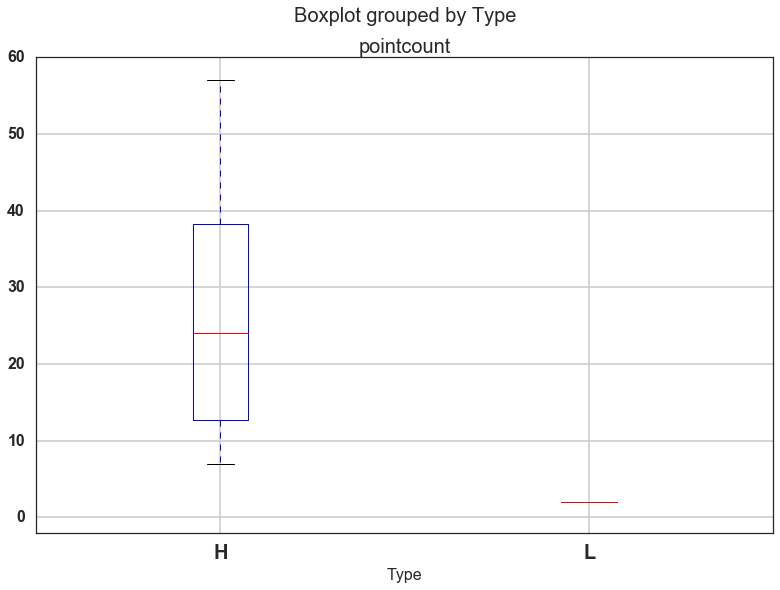

In [87]:
samplerecords[['pointcount', 'Type']].boxplot(column='pointcount', by='Type', sym='k.')
ax = plt.gca()
ax.set_ylim(-2, 60)


In [41]:
myfig = plt.gcf()
outfn = 'eagle_landsat_firematch_boxplot.png'
myfig.savefig(os.path.join(productdir, outfn), dpi=200, bb_inches='tight')

(-2, 67)

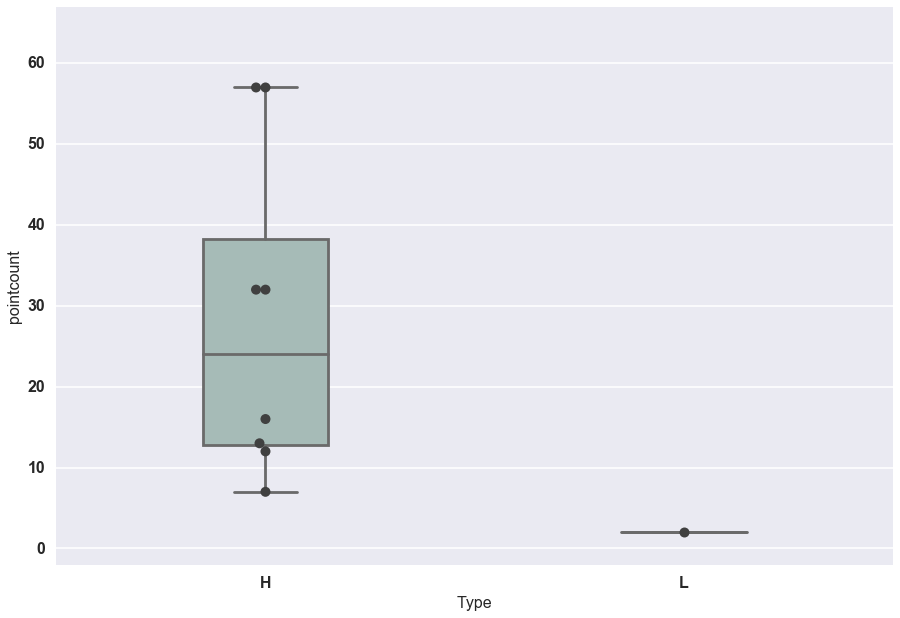

In [95]:
fig2 = plt.figure(1, figsize=(15, 10))
ax2 = fig2.add_subplot(111)
sns.boxplot(x='Type', y='pointcount', data=samplerecords,
    palette="Set3", saturation=0.3, width=.3, ax=ax2)
sns.swarmplot(
    x='Type', y='pointcount', data=samplerecords, color=".25", size=10, ax=ax2)
ax2.set_ylim(-2, 67)

In [97]:
outfn = 'eagle_landsat_firematch_boxplot.png'
fig2.savefig(os.path.join(productdir, outfn), dpi=200, bb_inches='tight')

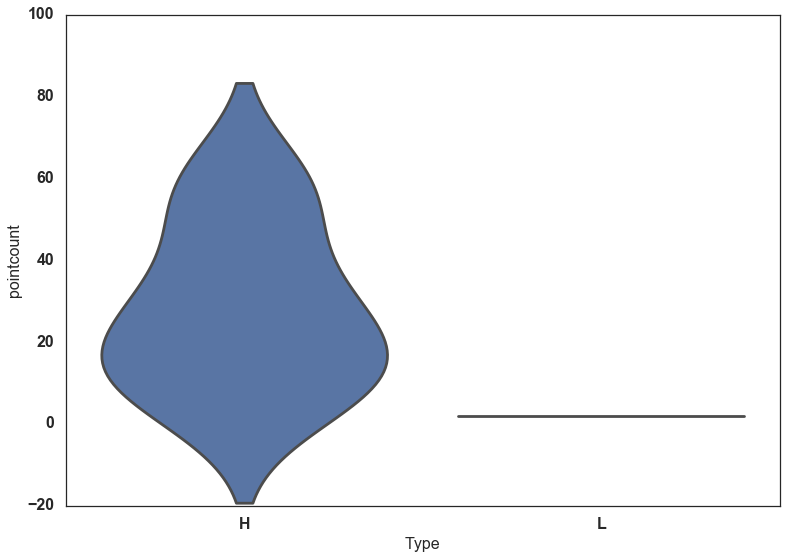

In [90]:
ax = sns.violinplot(x='Type', y='pointcount', data=samplerecords, inner=None)